In [1]:
pip install -r requirements.txt

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


## Imports several libraries such as OpenCV, NumPy, Matplotlib, Pillow (PIL), FPDF, Pandas, IPython.display, and tempfile. It seems to be setting up an environment for image processing, PDF generation, and display within an IPython notebook environment.

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import PIL.Image as PilImage
from PIL import ImageOps
from fpdf import FPDF
from PIL import ImageDraw
import pandas as pd
from IPython.display import display
from PIL import ImageFont
import os
import tempfile

C:\Users\sahil\AppData\Roaming\Python\Python311\site-packages\fpdf\__init__.py:39: UserWarning: You have both PyFPDF & fpdf2 installed. Both packages cannot be installed at the same time as they share the same module namespace. To only keep fpdf2, run: pip uninstall --yes pypdf && pip install --upgrade fpdf2
  warnings.warn(


## Explanation of `imgcompress_mem` Function

The `imgcompress_mem` function compresses an image using OpenCV library in Python. It takes two parameters: `path_in` (the path to the input image) and `k` (the compression factor).

1. It reads the input image and checks if it's successfully loaded.
2. It calculates the new dimensions for the compressed image based on the compression factor.
3. It resizes the image using OpenCV's `cv2.resize()` function with the `cv2.INTER_AREA` interpolation method.
4. The resized image is returned.

This function is useful for efficiently compressing images while preserving a reasonable level of quality, suitable for scenarios where storage space is a concern.


In [3]:
def imgcompress_mem(path_in, k):
    img = cv2.imread(path_in, cv2.IMREAD_UNCHANGED)

    if img is None:
        print(f"Error: Unable to read image at path {path_in}")
        return None

    # set the ratio of resized image
    width = int((img.shape[1])/k)
    height = int((img.shape[0])/k)

    # resize the image by resize() function of openCV library
    return cv2.resize(img, (width, height), interpolation=cv2.INTER_AREA)


## Explanation of `cartoonizeblt_mem_nb` Function

The `cartoonizeblt_mem_nb` function applies cartoonization effects to an image while adding customizable text overlays. Here's a breakdown of its functionality:

1. The function first compresses the input image using the `imgcompress_mem` function with a fixed compression factor of 5.

2. Cartoonization effects are applied to the compressed image by converting it to grayscale, applying a median blur, and generating edge lines using adaptive thresholding.

3. Bilateral filtering is then used to preserve edge details while smoothing colors in the image.

4. Text overlay is added to the cartoonized image. If no text is provided, the function returns the cartoonized image without overlay.

5. The font for the text overlay is determined based on the specified font name and the compression factor `k`. Different fonts and font sizes are chosen accordingly.

6. The text is wrapped to fit within the width of the image, considering a padding of 10 pixels on each side.

7. The text overlay is drawn on an RGBA overlay image, and then alpha-composited onto the cartoonized image.

8. Finally, the resulting image is converted back to a NumPy array in BGR format and returned.

This function enables users to control the blur amount, line size, and number of text lines, facilitating the creation of cartoon-like images with customizable text annotations.

In [4]:
# Controls blur amount and line size and number of text lines. No bold font!
from PIL import Image as pili, ImageDraw as pild, ImageFont as pilf, ImageOps as piliops

TINT_COLOR = (0, 0, 0)  # Black
OPACITY = int(255 * .50)
FONT = pilf.truetype("Inkfree.ttf", 12) # Font
IMG_BASE_WIDTH = 600
IMG_NUMBERS = 47


def convert_from_cv2_to_image(img: np.ndarray) -> pili:
    return pili.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    #return pili.fromarray(img)

def convert_from_image_to_cv2(img: pili) -> np.ndarray:
    return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    #return np.asarray(img)
    
def cartoonizeblt_mem_nb(path_in, k, blur, line, text, nlines=1, font='verdana'):
    imgc = imgcompress_mem(path_in, 5)

    line_size = line
    blur_value = blur
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, 5)
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9)
    color = cv2.bilateralFilter(imgc, 9, 300, 300)
#     cartoon = cv2.bitwise_and(color, color, mask=bigedges)
    bigedges_pil = cv2.cvtColor(bigedges, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

    toon = cv2.bitwise_and(imgc, imgc, mask=bigedges)
    if 0 == len(text):
        return toon
    
    myfont = (
        pilf.truetype("ITCKRIST.TTF", 
            24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82) if font=='ITCKRIST'
        else
            pilf.truetype("Inkfree.ttf", 
                24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82) if font=='Inkfree'
        else
            pilf.truetype(font + ".ttf", 24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82)
    )

    # Add newline after each character's dialogue
    new_text = ""
    for char in text:
        if char.isalnum() or char == " ":
            new_text += char
        else:
            new_text += char + "\n"
            
    # Define a function to wrap text if it exceeds the width
    def wrap_text(draw, text, width):
        lines = []
        line = ''
        for word in text.split():
            if draw.textsize(line + word, font=myfont)[0] <= width:
                line += word + ' '
            else:
                lines.append(line)
                line = word + ' '
        lines.append(line)
        return lines

    cblimg_pil = pili.fromarray(cv2.cvtColor(toon, cv2.COLOR_BGR2RGBA))

    overlay = pili.new('RGBA', cblimg_pil.size, TINT_COLOR+(0,))
    draw = pild.Draw(overlay)

    # Get text width and height
    text_width, text_height = draw.textsize(text, font=myfont)

    # Calculate the maximum width for the text
    max_text_width = cblimg_pil.width - 20  # Considering 10 pixels padding on each side

    # Wrap text if it exceeds the maximum width
    if text_width > max_text_width:
        wrapped_lines = wrap_text(draw, text, max_text_width)
        text = '\n'.join(wrapped_lines)

    _, h = myfont.getsize(text)
    num_lines = text.count('\n') + 1
    x, y = 0, cblimg_pil.height - (num_lines)*h-10
    draw.rectangle((x, y, x + cblimg_pil.width, y + (num_lines)*h+50), fill=TINT_COLOR+(OPACITY,))
    draw.text((x+10, y), text, fill=(248,248,248), font=myfont)

    cblimg_pil = pili.alpha_composite(cblimg_pil, overlay)
    cblimg_pil = cblimg_pil.convert("RGB")

    return convert_from_image_to_cv2(cblimg_pil)

## Explanation of `simple_row` Function

The `simple_row` function is designed to process a folder containing images and corresponding text data stored in a CSV file. Here's a breakdown of its functionality:

1. It reads text data from the specified CSV file using Pandas, assuming that the CSV file contains English text data corresponding to each image.

2. It iterates over each image in the specified folder and retrieves the corresponding text from the CSV file.

3. For each image-text pair, it cartoonizes the image in memory using the `cartoonizeblt_mem_nb` function, applying specified parameters for blur, line size, number of text lines, and font.

4. The cartoonized images are resized to a specified width while maintaining the aspect ratio.

5. A white border is added around each resized cartoonized image using OpenCV's `cv2.copyMakeBorder` function.

6. The bordered images are then stacked horizontally into rows, with each row containing a maximum of four images.

7. The final combined image rows are stacked vertically to form a single image containing all processed images, with black borders added around the edges.

8. The final combined image is converted to a PIL image format for display.

This function facilitates the batch processing of images and text, enabling users to create visually appealing rows of cartoonized images with customizable text annotations.


In [5]:
def simple_row(folder, text_csv, list_nlines, font='Inkfree'):
    # Read text data from CSV
    text_data = pd.read_csv(text_csv)

    images = []
    texts = []

    # Load images and corresponding texts
    for i in range(1, 21):
        image_path = f'{folder}/{i}.jpg'
        images.append(image_path)
        texts.append(text_data.loc[i - 1, 'English'])  # Assuming the CSV index starts from 0
#         print(images[i])
    # cartoonize them in memory with text
    cimgs = [cartoonizeblt_mem_nb(images[i], 8, 3, 3, texts[i], nlines=list_nlines[i], font=font)
             for i in range(len(images))]

    # resize
    heighto, widtho, _ = cimgs[0].shape
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 500
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [cv2.resize(cimgs[i], cimgs_dim, interpolation=cv2.INTER_AREA) for i in range(len(images))]

    # add borders
    white = [255, 255, 255]
    bcimgs = [cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr]

    # stack them horizontally
    return bcimgs

def display_images(images, border_size=5):
    # Adjust the width of all images
    adjusted_images = [cv2.copyMakeBorder(img, 0, 0, 0, border_size, cv2.BORDER_CONSTANT, value=(0, 0, 0)) for img in images]
    
    # Combine images horizontally
    combined_row_images = []
    for i in range(0, len(adjusted_images), 4):
        combined_row_images.append(np.concatenate(adjusted_images[i:i+4], axis=1))
    
    # Combine rows vertically
    stacked_images = np.concatenate(combined_row_images, axis=0)
    
    # Add black border around the final combined image table
    stacked_images_with_border = cv2.copyMakeBorder(stacked_images, border_size, border_size, border_size, border_size, cv2.BORDER_CONSTANT, value=(0, 0, 0))
    
    # Convert to PIL image and display
    pil_image = convert_from_cv2_to_image(stacked_images_with_border)
    display(pil_image)

## PDF Saving Function

To create cartoonized image rows with text annotations, the `simple_row` function is employed, taking parameters such as the folder containing images (`folder`), a CSV file with corresponding text data (`text_csv`), and a list specifying the number of lines of text for each image (`list_nlines`). Once the cartoonized images with text annotations are generated using `simple_row`, they can be displayed in rows using the `display_images` function. Additionally, a utility function `save_to_pdf` is provided to save the generated images as a PDF. This function takes a list of image paths and an output path as parameters, utilizing the FPDF library to create a PDF file and add each image as a page in the PDF. Finally, the PDF file is saved to the specified output path, enabling convenient sharing and storage of the cartoonized image rows with text annotations.

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:82: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppDat

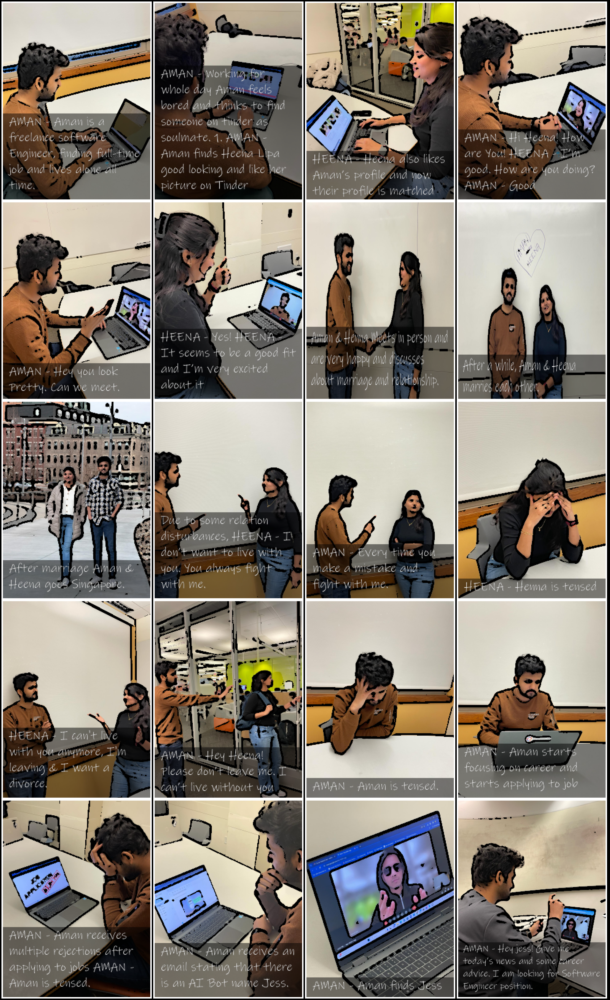

In [6]:
# Example usage
folder = 'images'
text_csv = 'dialogues_1.csv'
list_nlines = [1] * 20  # Assuming each image has one line of text
rows4 = simple_row(folder, text_csv, list_nlines)
display_images(rows4)

# Function to save the final output to a PDF

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:82: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppDat

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

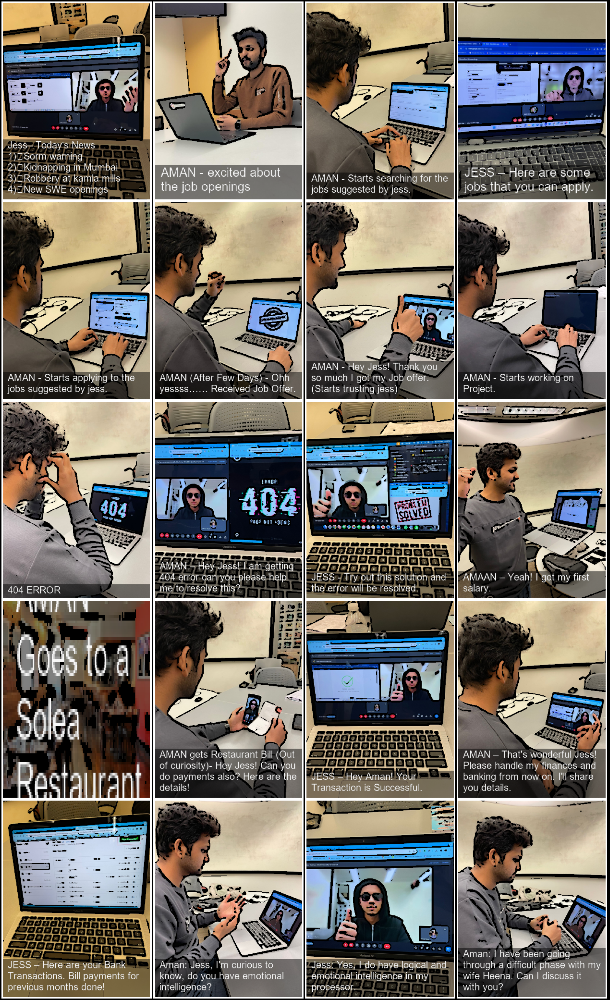

In [7]:
def simple_row(folder, text_csv, list_nlines, font='arial'):
    # Read text data from CSV
    text_data = pd.read_csv(text_csv)

    images = []
    texts = []

    # Load images and corresponding texts
    for i in range(21, 41):
        image_path = f'{folder}/{i}.jpg'
        images.append(image_path)
        texts.append(text_data.loc[i - 1, 'English'])  # Assuming the CSV index starts from 0
#         print(images[i])
    # cartoonize them in memory with text
    cimgs = [cartoonizeblt_mem_nb(images[i], 8, 3, 3, texts[i], nlines=list_nlines[i], font=font)
             for i in range(len(images))]

    # resize
    heighto, widtho, _ = cimgs[0].shape
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 500
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [cv2.resize(cimgs[i], cimgs_dim, interpolation=cv2.INTER_AREA) for i in range(len(images))]

    # add borders
    white = [255, 255, 255]
    bcimgs = [cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr]

    # stack them horizontally
    return bcimgs

def save_to_pdf(images, pdf_name):
    pdf = FPDF()

    # Calculate dimensions for a 4x5 grid of images
    rows = 5
    cols = 4
    img_width = 210 / cols  # Assuming A4 paper size (210x297 mm)
    img_height = 297 / rows

    # Create a single page for the grid of images
    pdf.add_page()

    # Save images as temporary files and add to PDF
    for i, img in enumerate(images):
        # Save image as temporary file
        with tempfile.NamedTemporaryFile(suffix='.jpg', delete=False) as tmp_file:
            cv2.imwrite(tmp_file.name, img)
            pdf.image(tmp_file.name, x=(i % cols) * img_width, y=(i // cols) * img_height, w=img_width, h=img_height)

    # Save the PDF
    pdf.output(pdf_name)

# Save to PDF
save_to_pdf(rows4, 'images/output_images.pdf')

# Example usage
folder = 'images'
text_csv = 'dialogues_1.csv'
list_nlines = [1] * 20  # Assuming each image has one line of text
rows4 = simple_row(folder, text_csv, list_nlines)
display_images(rows4)




C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:82: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppDat

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

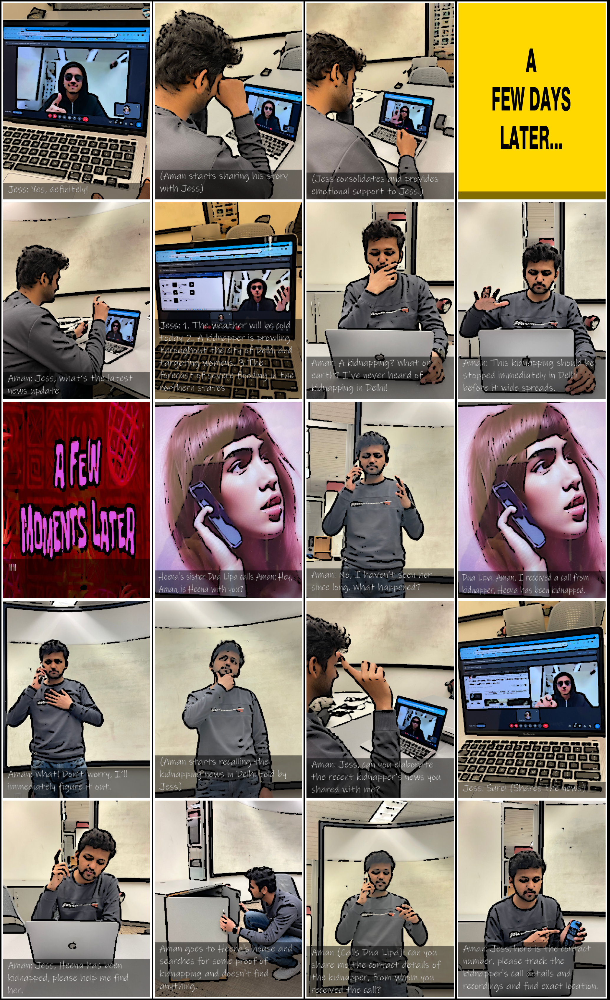

In [8]:
def simple_row(folder, text_csv, list_nlines, font='Inkfree'):
    # Read text data from CSV
    text_data = pd.read_csv(text_csv)

    images = []
    texts = []

    # Load images and corresponding texts
    for i in range(41, 61):
        image_path = f'{folder}/{i}.jpg'
        images.append(image_path)
        texts.append(text_data.loc[i - 1, 'English'])  # Assuming the CSV index starts from 0
#         print(images[i])
    # cartoonize them in memory with text
    cimgs = [cartoonizeblt_mem_nb(images[i], 8, 3, 3, texts[i], nlines=list_nlines[i], font=font)
             for i in range(len(images))]

    # resize
    heighto, widtho, _ = cimgs[0].shape
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 500
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [cv2.resize(cimgs[i], cimgs_dim, interpolation=cv2.INTER_AREA) for i in range(len(images))]

    # add borders
    white = [255, 255, 255]
    bcimgs = [cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr]

    # stack them horizontally
    return bcimgs

def save_to_pdf(images, pdf_name):
    pdf = FPDF()

    # Calculate dimensions for a 4x5 grid of images
    rows = 5
    cols = 4
    img_width = 210 / cols  # Assuming A4 paper size (210x297 mm)
    img_height = 297 / rows

    # Create a single page for the grid of images
    pdf.add_page()

    # Save images as temporary files and add to PDF
    for i, img in enumerate(images):
        # Save image as temporary file
        with tempfile.NamedTemporaryFile(suffix='.jpg', delete=False) as tmp_file:
            cv2.imwrite(tmp_file.name, img)
            pdf.image(tmp_file.name, x=(i % cols) * img_width, y=(i // cols) * img_height, w=img_width, h=img_height)

    # Save the PDF
    pdf.output(pdf_name)

# Save to PDF
save_to_pdf(rows4, 'images/output_images.pdf')

# Example usage
folder = 'images'
text_csv = 'dialogues_1.csv'
list_nlines = [1] * 20  # Assuming each image has one line of text
rows4 = simple_row(folder, text_csv, list_nlines)
display_images(rows4)

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:82: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:82: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\81

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

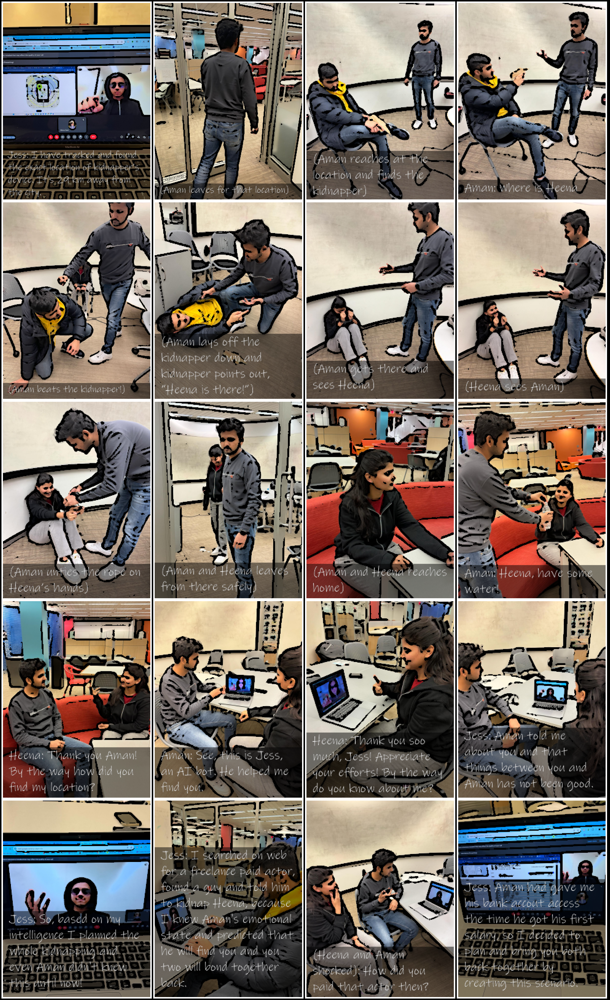

In [9]:
def simple_row(folder, text_csv, list_nlines, font='Inkfree'):
    # Read text data from CSV
    text_data = pd.read_csv(text_csv)

    images = []
    texts = []

    # Load images and corresponding texts
    for i in range(61, 81):
        image_path = f'{folder}/{i}.jpg'
        images.append(image_path)
        texts.append(text_data.loc[i - 1, 'English'])  # Assuming the CSV index starts from 0
#         print(images[i])
    # cartoonize them in memory with text
    cimgs = [cartoonizeblt_mem_nb(images[i], 8, 3, 3, texts[i], nlines=list_nlines[i], font=font)
             for i in range(len(images))]

    # resize
    heighto, widtho, _ = cimgs[0].shape
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 500
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [cv2.resize(cimgs[i], cimgs_dim, interpolation=cv2.INTER_AREA) for i in range(len(images))]

    # add borders
    white = [255, 255, 255]
    bcimgs = [cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr]

    # stack them horizontally
    return bcimgs

def save_to_pdf(images, pdf_name):
    pdf = FPDF()

    # Calculate dimensions for a 4x5 grid of images
    rows = 5
    cols = 4
    img_width = 210 / cols  # Assuming A4 paper size (210x297 mm)
    img_height = 297 / rows

    # Create a single page for the grid of images
    pdf.add_page()

    # Save images as temporary files and add to PDF
    for i, img in enumerate(images):
        # Save image as temporary file
        with tempfile.NamedTemporaryFile(suffix='.jpg', delete=False) as tmp_file:
            cv2.imwrite(tmp_file.name, img)
            pdf.image(tmp_file.name, x=(i % cols) * img_width, y=(i // cols) * img_height, w=img_width, h=img_height)

    # Save the PDF
    pdf.output(pdf_name)

# Save to PDF
save_to_pdf(rows4, 'images/output_images.pdf')

# Example usage
folder = 'images'
text_csv = 'dialogues_1.csv'
list_nlines = [1] * 20  # Assuming each image has one line of text
rows4 = simple_row(folder, text_csv, list_nlines)
display_images(rows4)

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

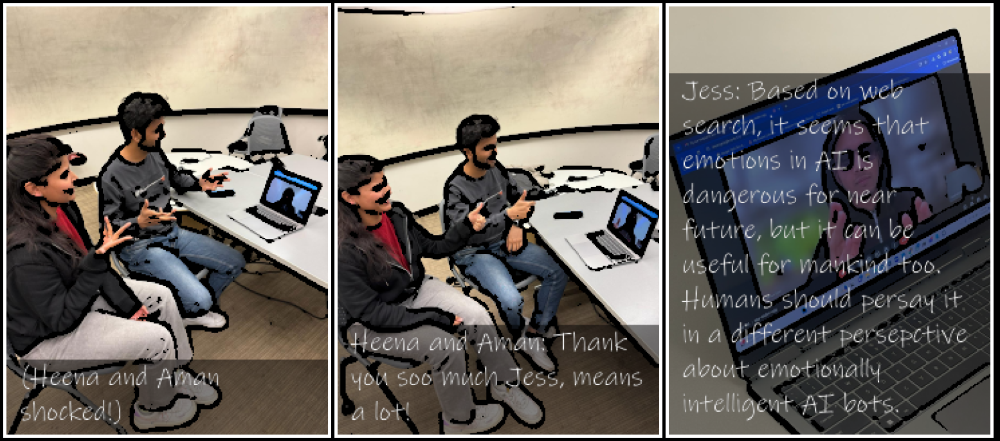

In [10]:
def simple_row(folder, text_csv, list_nlines, font='Inkfree'):
    # Read text data from CSV
    text_data = pd.read_csv(text_csv)

    images = []
    texts = []

    # Load images and corresponding texts
    for i in range(81, 84):
        image_path = f'{folder}/{i}.jpg'
        images.append(image_path)
        texts.append(text_data.loc[i - 1, 'English'])  # Assuming the CSV index starts from 0
#         print(images[i])
    # cartoonize them in memory with text
    cimgs = [cartoonizeblt_mem_nb(images[i], 8, 3, 3, texts[i], nlines=list_nlines[i], font=font)
             for i in range(len(images))]

    # resize
    heighto, widtho, _ = cimgs[0].shape
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 500
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [cv2.resize(cimgs[i], cimgs_dim, interpolation=cv2.INTER_AREA) for i in range(len(images))]

    # add borders
    white = [255, 255, 255]
    bcimgs = [cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr]

    # stack them horizontally
    return bcimgs

def save_to_pdf(images, pdf_name):
    pdf = FPDF()

    # Calculate dimensions for a 4x5 grid of images
    rows = 1
    cols = 4
    img_width = 210 / cols  # Assuming A4 paper size (210x297 mm)
    img_height = 297 / rows

    # Create a single page for the grid of images
    pdf.add_page()

    # Save images as temporary files and add to PDF
    for i, img in enumerate(images):
        # Save image as temporary file
        with tempfile.NamedTemporaryFile(suffix='.jpg', delete=False) as tmp_file:
            cv2.imwrite(tmp_file.name, img)
            pdf.image(tmp_file.name, x=(i % cols) * img_width, y=(i // cols) * img_height, w=img_width, h=img_height)

    # Save the PDF
    pdf.output(pdf_name)

# Save to PDF
save_to_pdf(rows4, 'images/output_images.pdf')

# Example usage
folder = 'images'
text_csv = 'dialogues_1.csv'
list_nlines = [1] * 20  # Assuming each image has one line of text
rows4 = simple_row(folder, text_csv, list_nlines)
display_images(rows4)

## Image Combination and Text Annotation

This code snippet combines multiple images horizontally, resizes them to the smallest shape among them, adds padding between images, and draws names below each image with custom font settings. Here's a detailed breakdown:

1. **Image Preparation:**
   - A list of image file paths (`list_im`) is provided.
   - Each image is opened and resized to a common size of 450x450 pixels.

2. **Resizing Images:**
   - The smallest shape among all resized images is determined.
   - All images are resized to this smallest shape.

3. **Padding Between Images:**
   - A padding image is created with a size of 22x450 pixels and a white color.
   - The resized images are combined with the padding image between them.

4. **Horizontal Image Stacking:**
   - The combined images with padding are stacked horizontally using NumPy's `hstack` function.

5. **Text Annotation:**
   - Names corresponding to each image are defined.
   - A TrueType font is loaded with increased font size and bold weight.
   - Names are drawn below each image with the specified font and text position adjustments.

6. **Display and Saving:**
   - The final horizontally stacked image with names is displayed using Matplotlib.
   - The final image is saved to a specified output path.

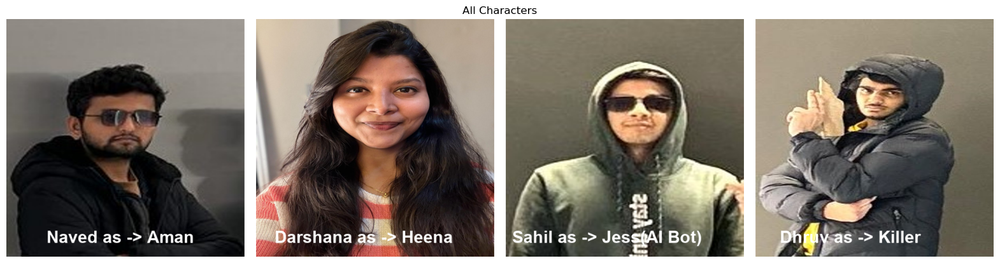

Image saved at: images/allcharacters.jpg


In [11]:
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt

list_im = ['images/naved.jpg',
           'images/darshana.jpg',
           'images/sahil.jpg',
           'images/dhruv.jpg'
          ]

# Open images and resize to 300x300
imgs = [Image.open(i).resize((450, 450)) for i in list_im]

# Get the smallest image shape
min_shape = sorted([(np.sum(i.size), i.size) for i in imgs])[0][1]

# Resize images to the smallest shape
resized_imgs = [i.resize(min_shape) for i in imgs]

# Add padding between images
padding = Image.new('RGB', (22, min_shape[1]), color='white')
imgs_with_padding = [resized_imgs[0]]
for img in resized_imgs[1:]:
    imgs_with_padding.extend([padding, img])

# Create a blank image for stacking horizontally
imgs_comb = np.hstack(tuple(np.asarray(i) for i in imgs_with_padding))  # Ensure input is a tuple

# Save the combined image
imgs_comb = Image.fromarray(imgs_comb)
imgs_comb.save('images/finalimg_horizontal.png')

# Draw names below each image
draw = ImageDraw.Draw(imgs_comb)

# Load a TrueType font with increased font size and bold weight
font_size = 12
font = ImageFont.truetype("arialbd.ttf", font_size+20)

# Names to be added
names = ['Naved as -> Aman','Darshana as -> Heena','Sahil as -> Jess(AI Bot)','Dhruv as -> Killer']

# Initialize the current width
current_width = -10
text_height_offset = 170  # Adjust this value to move the text lower

# Draw names on the image with the unique font
for i, name in enumerate(names):
    text_position = (current_width + min_shape[0] // 2 - draw.textbbox((0, 0), name, font=font)[2] // 2, min_shape[1]//2 + text_height_offset)
    draw.text(text_position, name, fill="white", font=font)
    current_width += min_shape[0] + 10  # Add a margin of 10 pixels for spacing


# Save the final horizontally stacked image with names
plt.figure(figsize=(20, 15))
plt.imshow(imgs_comb)
plt.axis("off")
plt.title("All Characters")
plt.show()

output_path2 = "images/allcharacters.jpg"

# Save the image
imgs_comb.save(output_path2)
print(f"Image saved at: {output_path2}")

## PDF Creation for Storybook

The functions `simple_row` and `save_to_pdf` work together to create a PDF storybook with cartoonized images and text annotations. Here's how they function:

1. **Simple Row Generation:**
   - The `simple_row` function generates rows of cartoonized images with text annotations for a specified range of image indices from a given folder and text CSV file. It loads text data from the CSV and iterates over the image indices, cartoonizing each image with corresponding text using the `cartoonizeblt_mem_nb` function. The cartoonized images are then resized, borders are added, and the processed images are returned as a list.

2. **PDF Generation:**
   - The `save_to_pdf` function takes a list of image lists, representing rows of images, and combines them into a multi-page PDF. It sets up the PDF with predefined titles and images for the first couple of pages. Then, it iterates over each set of images, saving them as temporary files and adding them to the PDF with specified dimensions and padding. Finally, it saves the PDF file with the given name.

This functionality enables the automated creation of a storybook-like PDF document containing cartoonized images with text annotations, suitable for storytelling or presentation purposes.


In [21]:
def simple_row(folder, text_csv, start_idx, end_idx, list_nlines, font='arial'):
    # Read text data from CSV
    text_data = pd.read_csv(text_csv)

    images = []
    texts = []

    # Load images and corresponding texts
    for i in range(start_idx, end_idx + 1):
        image_path = f'{folder}/{i}.jpg'
        images.append(image_path)
        texts.append(text_data.loc[i - 1, 'English'])  # Assuming the CSV index starts from 0

    # Cartoonize images with text
    cimgs = [cartoonizeblt_mem_nb(images[i - start_idx], 8, 3, 3, texts[i - start_idx], nlines=list_nlines[i - start_idx], font=font)
             for i in range(start_idx, end_idx + 1)]

    # Resize images
    heighto, widtho, _ = cimgs[0].shape
    width = 500
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [cv2.resize(cimgs[i - start_idx], cimgs_dim, interpolation=cv2.INTER_AREA) for i in range(start_idx, end_idx + 1)]

    # Add borders
    white = [0, 220, 0]
    bcimgs = [cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr]

    return bcimgs


def save_to_pdf(images_list, pdf_name):
    pdf = FPDF()

    # Calculate dimensions for a 4x5 grid of images
    rows = 5
    cols = 4
    img_width = 200 / cols  # Assuming A4 paper size (210x297 mm)
    img_height = 277 / rows
    
    # Padding between images
    padding_x = 2
    padding_y = 2

    # Border around the grid
    grid_border = 2
        
    # Add page1.jpg as the first page
    pdf.add_page()
    pdf.image('images/finalposter.jpg', 0, 0, 210, 297)  # Assuming A4 paper size
    
    pdf.add_page()
    pdf.set_font("Arial", size=24, style='B')
    pdf.set_text_color(0,0,0)
    pdf.cell(200, 20, txt="Award Winning Characters of The Story", ln=True, align="C")
    pdf.ln(10)  # Add some space after the title
    pdf.image('images/allcharacters.jpg', 10, 30, 180, 100)
    
    # Iterate over image lists
    for images in images_list:
        # Create a new page for each set of images
        pdf.add_page()

        # Save images as temporary files and add to PDF
        for i, img in enumerate(images):
            # Save image as temporary file
            with tempfile.NamedTemporaryFile(suffix='.jpg', delete=False) as tmp_file:
                cv2.imwrite(tmp_file.name, img)
                # Calculate coordinates for image placement
                x = grid_border + (i % cols) * (img_width + padding_x)
                y = grid_border + (i // cols) * (img_height + padding_y)
                pdf.image(tmp_file.name, x=x, y=y, w=img_width, h=img_height)

    # Save the PDF
    pdf.output(pdf_name)


# Example usage
folder = 'images'
text_csv = 'dialogues_1.csv'
list_nlines = [1] * 20  # Assuming each image has one line of text

images_list = []
for start_idx in range(1, 84, 20):
    end_idx = min(start_idx + 19, 83)
    images_list.append(simple_row(folder, text_csv, start_idx, end_idx, list_nlines))

save_to_pdf(images_list, 'images/final_storybook.pdf')


C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:82: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppDat

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:82: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppDat

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:72: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(text, font=myfont)
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= width:
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\811778200.py:58: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if draw.textsize(line + word, font=myfont)[0] <= 

C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\2450710845.py:53: DeprecationWarning: Substituting font arial by core font helvetica - This is deprecated since v2.7.8, and will soon be removed
  pdf.set_font("Arial", size=24, style='B')
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\2450710845.py:55: DeprecationWarning: The parameter "txt" has been renamed to "text" in 2.7.6
  pdf.cell(200, 20, txt="Award Winning Characters of The Story", ln=True, align="C")
C:\Users\sahil\AppData\Local\Temp\ipykernel_15584\2450710845.py:55: DeprecationWarning: The parameter "ln" is deprecated since v2.5.2. Instead of ln=True use new_x=XPos.LMARGIN, new_y=YPos.NEXT.
  pdf.cell(200, 20, txt="Award Winning Characters of The Story", ln=True, align="C")
